# **Mantenimiento Predictivo de Máquinas**



**¿Qué es el Mantenimiento Predictivo?**

El mantenimiento predictivo **es una técnica que utiliza herramientas y técnicas de análisis de datos para detectar anomalías en el funcionamiento y posibles defectos en los equipos y procesos, de modo que puedan solucionarse antes de que sobrevenga el fallo**. Al igual que el análisis predictivo permite anticipar, por ejemplo, los movimientos de los mercados o las fluctuaciones en la demanda de energía, el mantenimiento predictivo utiliza el análisis de datos para adelantarse a los fallos de los sistemas y es parte fundamental del Internet Industrial de las Cosas (IIoT).


**¿Cómo funciona el mantenimiento predictivo?**

Para hacer el seguimiento del estado de los equipos y avisar a los técnicos de los próximos fallos, el mantenimiento preventivo cuenta con tres componentes principales:

*   **Los sensores y los dispositivos conectados** instalados en las máquinas envían datos sobre el estado y el rendimiento de la máquina en tiempo real gracias a tecnologías del Internet de las Cosas (IoT), que permiten la comunicación entre las máquinas y los sistemas de análisis.
*   **Las soluciones de software** y el almacenamiento en la nube (cloud computing) permiten aplicar la minería de datos (data mining) y recopilar y analizar enormes cantidades de datos usando aplicaciones de big data.
*  **Los modelos predictivos** se alimentan con los datos procesados y utilizan tecnologías de aprendizaje automático (machine learning) para establecer patrones y comparaciones, elaborar predicciones de fallos y programar el mantenimiento antes de que ocurran.

Fuente: https://www.iberdrola.com/innovacion/mantenimiento-predictivo







## **Configuración del entorno**

In [1]:
isRunningInColab = False

In [2]:
#Conexión a cuenta google drive
if isRunningInColab:
    from google.colab import drive
    drive.mount('/content/drive')

In [ ]:

if isRunningInColab:
    !pip install -r '/content/drive/MyDrive/ColabNotebooks/EscuelaDatosRGG/Portafolio/proyecto-portafolio/notebooks/requirements.txt' --user
else:
    !pip install -r './requirements.txt' --user
   

#!pip install dataprep
#!pip install anai-opensource https://anai-wheels.s3.ap-south-1.amazonaws.com/TensorFM-1.0.4-py3-none-any.whl

In [61]:
#Importación de librerías
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)

import pandas as pd
from datetime import datetime, timedelta
import numpy as np
from sklearn.preprocessing import MinMaxScaler



from dataprep.datasets import load_dataset
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff

import anai
from anai.preprocessing import Preprocessor
from anai.unsupervised import anomaly_detector



## **Carga de los datos**

El dataset se encuentra disponible en:
[Microsoft-Azure-Predictive-Maintenance](https://www.kaggle.com/datasets/arnabbiswas1/microsoft-azure-predictive-maintenance)

Esta formado por cinco archivos en formato csv los cuales contienen datos de identificación de las máquinas, medición de sus sensores, registro de errores, registro de fallas y registro de reemplazo de sus componentes. 

In [5]:
#ruta de ubicacion de los datos
DATA_PATH = '../data/mttoPredic/'
if isRunningInColab:
    DATA_PATH = '/content/drive/MyDrive/ColabNotebooks/EscuelaDatosRGG/Portafolio/proyecto-portafolio/data/mttoPredic/'

#nombres de los archivos 
files = {
     'errors':'PdM_errors.csv'
    ,'failures':'PdM_failures.csv'
    ,'machines':'PdM_machines.csv'
    ,'maint':'PdM_maint.csv'
    ,'telemetry':'PdM_telemetry.csv'
  }



In [6]:
#cargue de archivos dataset 
dataframe = dict()
for key, value in files.items():
  dataframe[key] = pd.read_csv(DATA_PATH+value)


In [7]:
#funcion para explorar los datos básicos del dataframe
def show_info_dataframe(label,df):
  print('***** Dataframe: ',label,' *****')
  df.info();
  print('--------------------------------')

## **Revisión preliminar de los datos**

In [8]:
for label,df in dataframe.items():
  show_info_dataframe(label,df)

***** Dataframe:  errors  *****
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3919 entries, 0 to 3918
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   3919 non-null   object
 1   machineID  3919 non-null   int64 
 2   errorID    3919 non-null   object
dtypes: int64(1), object(2)
memory usage: 92.0+ KB
--------------------------------
***** Dataframe:  failures  *****
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 761 entries, 0 to 760
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   datetime   761 non-null    object
 1   machineID  761 non-null    int64 
 2   failure    761 non-null    object
dtypes: int64(1), object(2)
memory usage: 18.0+ KB
--------------------------------
***** Dataframe:  machines  *****
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 3 columns):
 #   Column     Non-Null Coun

In [9]:
#Se transforma la columna datetime en tipo fecha en todos los dataframes
dataframe['errors']['datetime'] = pd.to_datetime(dataframe['errors']['datetime'], format="%Y-%m-%d %H:%M:%S")
dataframe['failures']['datetime'] = pd.to_datetime(dataframe['failures']['datetime'], format="%Y-%m-%d %H:%M:%S")
dataframe['maint']['datetime'] = pd.to_datetime(dataframe['maint']['datetime'], format="%Y-%m-%d %H:%M:%S")
dataframe['telemetry']['datetime'] = pd.to_datetime(dataframe['telemetry']['datetime'], format="%Y-%m-%d %H:%M:%S")

In [10]:
#Se transforma la columna machineID en tipo string en todos los dataframes
dataframe['errors']['machineID'] = dataframe['errors']['machineID'].apply(str)
dataframe['failures']['machineID'] = dataframe['failures']['machineID'].apply(str)
dataframe['maint']['machineID'] = dataframe['maint']['machineID'].apply(str)
dataframe['telemetry']['machineID'] = dataframe['telemetry']['machineID'].apply(str)
dataframe['machines']['machineID'] = dataframe['machines']['machineID'].apply(str)

In [11]:
for label,df in dataframe.items():
  show_info_dataframe(label,df)

***** Dataframe:  errors  *****
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3919 entries, 0 to 3918
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   datetime   3919 non-null   datetime64[ns]
 1   machineID  3919 non-null   object        
 2   errorID    3919 non-null   object        
dtypes: datetime64[ns](1), object(2)
memory usage: 92.0+ KB
--------------------------------
***** Dataframe:  failures  *****
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 761 entries, 0 to 760
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   datetime   761 non-null    datetime64[ns]
 1   machineID  761 non-null    object        
 2   failure    761 non-null    object        
dtypes: datetime64[ns](1), object(2)
memory usage: 18.0+ KB
--------------------------------
***** Dataframe:  machines  *****
<class 'pandas.core.frame.DataFram

In [12]:
#Dataset de Equipos o Maquinas
dataframe['machines'].head()

,machineID,model,age
0,1,model3,18
1,2,model4,7
2,3,model3,8
3,4,model3,7
4,5,model3,2


In [13]:
#Dataset de Señales o telemetría
dataframe['telemetry'].head()

,datetime,machineID,volt,rotate,pressure,vibration
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511


In [14]:
#Dataset de Mantenimientos
dataframe['maint'].head()

,datetime,machineID,comp
0,2014-06-01 06:00:00,1,comp2
1,2014-07-16 06:00:00,1,comp4
2,2014-07-31 06:00:00,1,comp3
3,2014-12-13 06:00:00,1,comp1
4,2015-01-05 06:00:00,1,comp4


In [15]:
#Dataset de errores
dataframe['errors'].head()

,datetime,machineID,errorID
0,2015-01-03 07:00:00,1,error1
1,2015-01-03 20:00:00,1,error3
2,2015-01-04 06:00:00,1,error5
3,2015-01-10 15:00:00,1,error4
4,2015-01-22 10:00:00,1,error4


In [16]:
#Dataset de fallas
dataframe['failures'].head()

,datetime,machineID,failure
0,2015-01-05 06:00:00,1,comp4
1,2015-03-06 06:00:00,1,comp1
2,2015-04-20 06:00:00,1,comp2
3,2015-06-19 06:00:00,1,comp4
4,2015-09-02 06:00:00,1,comp4


## **Explorando los datos**

### **Datos de máquinas**
Contiene el modelo y la edad de las máquinas.

**Archivo:** PdM_Machines.csv


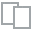
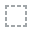
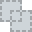
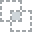
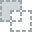
...
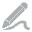
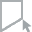
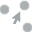
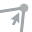
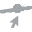

In [17]:
plot(dataframe['machines'])

Se encuentran tres variables en el dataframe:


1.   **machineID**: variable numérica de identificación de la máquina.  
2.   **model**: variable categórica que indica el tipo o modelo de máquina.
3.   **age**: variable numérica con la edad de la máquina.


No se evidencian valores nulos o vacíos.

### **Datos de telemetría**
Consiste en el registro de la medición del voltaje, rotación, presión y vibración de cien máquinas, cada hora durante el año 2015.

**Archivo:** PdM_telemetry.csv


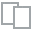
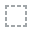
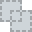
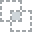
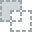
...
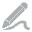
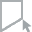
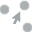
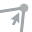
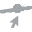

In [18]:
plot(dataframe['telemetry'])

Se encuentran seis variables en el dataframe:


1.   **datetime**: variable de tipo fecha.  
2.   **machineID**: variable numérica de identificación de la máquina.
3.   **volt**: variable numérica con la medición del voltaje.
4.   **rotate**: variable numérica con la medición de la rotación.
3.   **pressure**: variable numérica con la medición de la presión.
3.   **vibration**: variable numérica con la medición de la vibración.


No se evidencian  valores nulos o vacíos.

### **Datos de mantenimiento**
Cada registro de esta tabla contiene el reemplazo un componente de una máquina. Los componentes se reemplazan en dos situaciones: 

1.   **Mantenimiento Proactivo:** Durante la visita programada regular, el técnico lo reemplazó.
2.   **Mantenimiento Reactivo:** Un componente se descompone y luego el técnico realiza un mantenimiento no programado para reemplazar el componente. Esto se considera una falla y los datos correspondientes se capturan en Fallas.

Los datos de mantenimiento tienen registros de 2014 y 2015. Estos datos se redondean a la hora más cercana ya que los datos de telemetría se recopilan a una tasa por hora.

**Archivo:** PdM_maint.csv


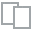
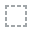
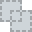
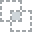
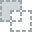
...
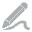
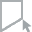
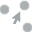
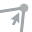
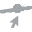

In [19]:
plot(dataframe['maint'])

Se encuentran tres variables en el dataframe:


1.   **datetime**: variable de tipo fecha.  
2.   **machineID**: variable numérica de identificación de la máquina.
3.   **comp**: variable categórica que identifica el tipo de componente reemplazado en la máquina.


No se evidencia valores nulos o vacíos.

### **Datos de errores**
Estos son errores encontrados por las máquinas mientras están en condiciones de funcionamiento. Dado que estos errores no apagan las máquinas, no se consideran fallas. La fecha y hora del error se redondean a la hora más cercana, ya que los datos de telemetría se recopilan a una tasa por hora.

**Archivo:** PdM_errors.csv


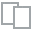
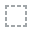
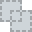
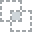
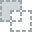
...
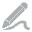
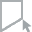
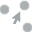
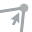
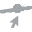

In [20]:
plot(dataframe['errors'])

Se encuentran tres variables en el dataframe:


1.   **datetime**: variable de tipo fecha.  
2.   **machineID**: variable numérica de identificación de la máquina.
3.   **errorID**: variable categórica que identifica el tipo de error presentado en la máquina.


No se evidencian valores nulos o vacíos.


### **Datos de fallas**
Cada registro representa el reemplazo de un componente debido a una falla. Estos datos son un subconjunto de los datos de mantenimiento. Estos datos se redondean a la hora más cercana ya que los datos de telemetría se recopilan a una tasa por hora.

**Archivo:** PdM_failures.csv


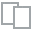
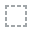
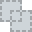
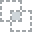
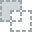
...
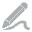
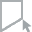
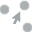
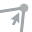
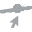

In [21]:
plot(dataframe['failures'])

Se encuentran tres variables en el dataframe:


1.   **datetime**: variable de tipo fecha.  
2.   **machineID**: variable numérica de identificación de la máquina.
3.   **failure**: variable categórica que identifica el tipo de componente de la máquina que presenta la falla.


No se evidencian valores nulos o vacíos.


### **Consolidación de datos**

In [22]:
#se configura pandas para que muestre todas las columnas del dataframe
pd.set_option('display.max_columns', None)

In [23]:
#se consolidan los datos de telemetría con máquinas
df_machines = pd.merge(dataframe['telemetry'],dataframe['machines'], left_on='machineID', right_on='machineID', how='left')
df_machines.head()

,datetime,machineID,volt,rotate,pressure,vibration,model,age
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686,model3,18
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973,model3,18
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847,model3,18
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144,model3,18
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511,model3,18


In [24]:
#Se normaliza los datos del modelo en el dataframe consolidado
one_hot = pd.get_dummies(df_machines['model'])
df_machines = df_machines.join(one_hot)
df_machines = df_machines.drop('model',axis=1)
df_machines.head()

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686,18,0,0,1,0
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973,18,0,0,1,0
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847,18,0,0,1,0
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144,18,0,0,1,0
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511,18,0,0,1,0


In [25]:
#Se normaliza los datos de errores
one_hot = pd.get_dummies(dataframe['errors']['errorID'])
df_errors = dataframe['errors'].join(one_hot)
df_errors = df_errors.drop('errorID',axis=1)
df_errors.head()

,datetime,machineID,error1,error2,error3,error4,error5
0,2015-01-03 07:00:00,1,1,0,0,0,0
1,2015-01-03 20:00:00,1,0,0,1,0,0
2,2015-01-04 06:00:00,1,0,0,0,0,1
3,2015-01-10 15:00:00,1,0,0,0,1,0
4,2015-01-22 10:00:00,1,0,0,0,1,0


In [26]:
#se agregan los registros de errores
df_machines = pd.merge(df_machines,df_errors, left_on=['machineID','datetime'], right_on=['machineID','datetime'], how='left').fillna(0)
df_machines.head()

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0


In [27]:
df_maint =dataframe['maint']
df_maint.loc[df_maint.comp == "comp1", "comp"] = "maintComp1"
df_maint.loc[df_maint.comp == "comp2", "comp"] = "maintComp2"
df_maint.loc[df_maint.comp == "comp3", "comp"] = "maintComp3"
df_maint.loc[df_maint.comp == "comp4", "comp"] = "maintComp4"
one_hot = pd.get_dummies(df_maint['comp'])
df_maint = df_maint.join(one_hot)
df_maint = df_maint.drop('comp',axis=1)
df_maint.head()

,datetime,machineID,maintComp1,maintComp2,maintComp3,maintComp4
0,2014-06-01 06:00:00,1,0,1,0,0
1,2014-07-16 06:00:00,1,0,0,0,1
2,2014-07-31 06:00:00,1,0,0,1,0
3,2014-12-13 06:00:00,1,1,0,0,0
4,2015-01-05 06:00:00,1,0,0,0,1


In [28]:
#se agregan los registros de mantenimiento
df_machines = pd.merge(df_machines,df_maint, left_on=['machineID','datetime'], right_on=['machineID','datetime'], how='left').fillna(0)
df_machines.head()

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [29]:
dataframe['failures'].head()

,datetime,machineID,failure
0,2015-01-05 06:00:00,1,comp4
1,2015-03-06 06:00:00,1,comp1
2,2015-04-20 06:00:00,1,comp2
3,2015-06-19 06:00:00,1,comp4
4,2015-09-02 06:00:00,1,comp4


In [30]:
#se agregan los registros de fallas
df_machines = pd.merge(df_machines,dataframe['failures'], left_on=['machineID','datetime'], right_on=['machineID','datetime'], how='left').fillna('none')
df_machines.head()


,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
0,2015-01-01 06:00:00,1,176.217853,418.504078,113.077935,45.087686,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
1,2015-01-01 07:00:00,1,162.879223,402.747490,95.460525,43.413973,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
2,2015-01-01 08:00:00,1,170.989902,527.349825,75.237905,34.178847,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
3,2015-01-01 09:00:00,1,162.462833,346.149335,109.248561,41.122144,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
4,2015-01-01 10:00:00,1,157.610021,435.376873,111.886648,25.990511,18,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none


Ahora se aplica normalización de los datos continuos, para ello se aplicará el método **MinMax** 
a las columnas *'volt', 'rotate','pressure','vibration','age'*

In [31]:
scaler = MinMaxScaler()
df_machines[['volt', 'rotate','pressure','vibration','age']] = scaler.fit_transform(df_machines[['volt', 'rotate','pressure','vibration','age']])
df_machines.head()

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
0,2015-01-01 06:00:00,1,0.499928,0.503194,0.459050,0.487945,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
1,2015-01-01 07:00:00,1,0.415395,0.474884,0.328274,0.460912,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
2,2015-01-01 08:00:00,1,0.466796,0.698752,0.178160,0.311752,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
3,2015-01-01 09:00:00,1,0.412756,0.373197,0.430624,0.423896,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
4,2015-01-01 10:00:00,1,0.382001,0.533508,0.450207,0.179498,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none


In [32]:
#mantenimientos preventivos: 1864
df_machines.query("failure =='none' & (maintComp1 > 0 | maintComp2 > 0 | maintComp3 > 0 | maintComp4 > 0)")


,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
457,2015-01-20 06:00:00,1,0.383044,0.546875,0.400279,0.440257,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,none
458,2015-01-20 06:00:00,1,0.383044,0.546875,0.400279,0.440257,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,none
818,2015-02-04 06:00:00,1,0.638733,0.538599,0.280616,0.436253,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,none
819,2015-02-04 06:00:00,1,0.638733,0.538599,0.280616,0.436253,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,none
1179,2015-02-19 06:00:00,1,0.680016,0.429252,0.400456,0.328961,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,none
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
875214,2015-10-10 06:00:00,100,0.595306,0.563861,0.437920,0.392105,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,none
875215,2015-10-10 06:00:00,100,0.595306,0.563861,0.437920,0.392105,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,none
875575,2015-10-25 06:00:00,100,0.356515,0.493482,0.328794,0.458787,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,none
875935,2015-11-09 06:00:00,100,0.302244,0.405570,0.331824,0.426186,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,none


In [33]:
#mantenimientos reactivos: 18
df_machines.query("failure !='none' & (maintComp1 <= 0 & maintComp2 <= 0 & maintComp3 <= 0 & maintComp4 <= 0)")

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
131620,2015-01-02 03:00:00,16,0.463844,0.479476,0.435131,0.370018,0.15,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1
131621,2015-01-02 03:00:00,16,0.463844,0.479476,0.435131,0.370018,0.15,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp3
140393,2015-01-02 03:00:00,17,0.385099,0.481313,0.339715,0.728270,0.70,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp4
184254,2015-01-02 03:00:00,22,0.679948,0.518089,0.506611,0.471268,0.70,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1
298302,2015-01-02 03:00:00,35,0.489011,0.664996,0.294238,0.362715,0.85,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1
386026,2015-01-02 03:00:00,45,0.656072,0.473185,0.363589,0.696452,0.70,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1
438652,2015-01-02 03:00:00,51,0.624662,0.265836,0.207764,0.480001,0.95,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1
482501,2015-01-02 03:00:00,56,0.713274,0.572354,0.519333,0.346663,0.50,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp3
500042,2015-01-02 03:00:00,58,0.442696,0.346806,0.408566,0.386529,0.25,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp2
508813,2015-01-02 03:00:00,59,0.455495,0.683998,0.264027,0.438231,0.85,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,comp1


In [34]:
#fallas: 1122
df_machines.query("failure !='none'")

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
96,2015-01-05 06:00:00,1,0.519481,0.649215,0.449809,0.605776,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,comp4
97,2015-01-05 06:00:00,1,0.519481,0.649215,0.449809,0.605776,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,comp4
1539,2015-03-06 06:00:00,1,0.639607,0.572110,0.282796,0.384321,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,comp1
2620,2015-04-20 06:00:00,1,0.524220,0.373580,0.403994,0.393142,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,comp2
4061,2015-06-19 06:00:00,1,0.572531,0.637047,0.401569,0.631309,0.90,0,0,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,comp4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867650,2015-11-29 06:00:00,99,0.684465,0.467664,0.481959,0.334522,0.70,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,comp3
868010,2015-12-14 06:00:00,99,0.347355,0.459497,0.467470,0.419533,0.70,1,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,comp4
869451,2015-02-12 06:00:00,100,0.819649,0.621795,0.343576,0.617831,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,comp1
874494,2015-09-10 06:00:00,100,0.661935,0.687021,0.294752,0.390700,0.25,0,0,0,1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,comp1


/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4868: RuntimeWarning: overflow encountered in long_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))
/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4869: RuntimeWarning: invalid value encountered in sqrt
  z = con_minus_dis / np.sqrt(var)



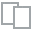
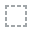
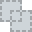
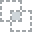
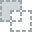
...
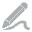
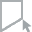
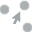
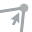
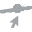

In [35]:
plot_correlation(df_machines)

In [36]:
df_machines.describe()

,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4
count,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000,877209.000000
mean,0.465472,0.553620,0.368366,0.412013,0.566514,0.160030,0.169990,0.349988,0.319991,0.001155,0.001126,0.000955,0.000830,0.000407,0.000824,0.000901,0.000821,0.000838
std,0.098303,0.094682,0.082041,0.086764,0.291377,0.366634,0.375624,0.476966,0.466473,0.033963,0.033541,0.030893,0.028796,0.020169,0.028697,0.029996,0.028638,0.028934
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.399087,0.491985,0.313714,0.353730,0.350000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.464384,0.555357,0.365139,0.409621,0.600000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.530288,0.617556,0.418070,0.466929,0.800000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [37]:
df_machines.head(5)

,datetime,machineID,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
0,2015-01-01 06:00:00,1,0.499928,0.503194,0.459050,0.487945,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
1,2015-01-01 07:00:00,1,0.415395,0.474884,0.328274,0.460912,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
2,2015-01-01 08:00:00,1,0.466796,0.698752,0.178160,0.311752,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
3,2015-01-01 09:00:00,1,0.412756,0.373197,0.430624,0.423896,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
4,2015-01-01 10:00:00,1,0.382001,0.533508,0.450207,0.179498,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none


### **Preguntas sobre los datos**

A continuación se plantean algunas preguntas sobre el conjunto de datos luego de su exploración:

1. ¿Todas las máquinas fallaron?
1. ¿Cuál es la máquina con más/menos fallas?
1. ¿Cuál es el modelo de máquina con más/menos fallas?
1. ¿Cuál es la edad de la máquina con más fallas?
1. ¿Cuál es la edad promedio de las máquinas con fallas?
1. ¿Cuántas máquinas se tienen con el modelo que presenta más fallas?
1. ¿Cuál es la frecuencia de falla por tipo de máquina?
1. ¿A mayor edad de la máquina, mayor falla?
1. ¿Cuántas máquinas fallan por mes?

1. ¿Todas las máquinas presentan errores?
1. ¿Cuál es la máquina con más/menos errores?
1. ¿Cuál es el modelo de máquina con más/menos errores?
1. ¿Cuál es la edad de la máquina con más errores?
1. ¿Cuál es la edad promedio de las máquinas con errores?
1. ¿Cuántas máquinas se tienen con el modelo que presenta más errores?
1. ¿Cuál es la frecuencia de error por tipo de máquina?
1. ¿A mayor edad de la máquina, mayor error?
1. ¿Cuántas máquinas presentan errores por mes?

1. ¿Cuál es el componente que más se reemplaza por tipo de máquina?
1. ¿Cuales son los valores promedio de las mediciones de las máquinas que presentan más fallas?
1. ¿Cuántos mantenimientos preventivos se ejecutaron?
1. ¿Cuántos mantenimientos reactivos se ejecutaron?








Para dar respuesta al conjunto de preguntas, se hace necesario consolidar los datos en un único conjunto.

#### ¿Todas las máquinas fallaron?

In [38]:
dfFails = df_machines[df_machines['failure']!='none'].groupby(['machineID','model1','model2','model3','model4'])['failure'].count().reset_index()
#dfFails['totalFails'] = dfFails[['failure']].count(axis=1) 
dfFails.head()


,machineID,model1,model2,model3,model4,failure
0,1,0,0,1,0,11
1,10,0,0,1,0,8
2,100,0,0,0,1,3
3,11,0,1,0,0,9
4,12,0,0,1,0,9


In [39]:
dfWithOutFails = df_machines[df_machines['failure']=='none'].groupby(['machineID','model1','model2','model3','model4'])['failure'].count().reset_index()
#dfFails['totalFails'] = dfFails[['failure']].count(axis=1) 
dfWithOutFails.head()

,machineID,model1,model2,model3,model4,failure
0,1,0,0,1,0,8761
1,10,0,0,1,0,8767
2,100,0,0,0,1,8763
3,11,0,1,0,0,8762
4,12,0,0,1,0,8764


In [40]:
labelsKeys = list(dfFails.columns[:5].values)
indexWithOutFails = dfWithOutFails.set_index(labelsKeys).index
indexFails = dfFails.set_index(labelsKeys).index
dfWithOutFails[~indexWithOutFails.isin(indexFails)]

,machineID,model1,model2,model3,model4,failure
56,6,0,0,1,0,8772
75,77,0,0,0,1,8769


No, se encuentra que de las cien máquinas, **sólo dos no presentaron fallas, la máquina 6 y 77**, respectivamente.

#### ¿Cuál es la máquina con más/menos fallas?

In [41]:
#maquinas con mas fallas
dfFails.sort_values('failure', ascending=False).head(5)


,machineID,model1,model2,model3,model4,failure
96,98,0,1,0,0,26
97,99,1,0,0,0,24
15,22,1,0,0,0,24
9,17,1,0,0,0,23
5,13,1,0,0,0,22


**La máquina 98 es la que presentó más fallas, veinteseis fallas en total**, seguida de las máquinas 99 y 22, con veinticuatro fallas cada una.

In [42]:
#maquinas con menos fallas
dfFails.sort_values('failure', ascending=True).head(10)

,machineID,model1,model2,model3,model4,failure
69,72,0,0,0,1,2
41,46,0,0,0,1,3
2,100,0,0,0,1,3
53,57,0,0,0,1,3
28,34,0,0,0,1,4
22,29,0,0,0,1,4
36,41,0,0,0,1,4
83,86,0,0,1,0,5
23,3,0,0,1,0,5
76,8,0,0,1,0,5


**La máquina 72 es la que presentó menos fallas, sólo se registraron dos fallas**, igualmente cabe señalar que las máquinas 77 y 6, no registraron falla alguna.

#### ¿Cuál es el modelo de máquina con más/menos fallas?

La máquina con **más fallas es modelo model2**.

La máquina con **menos fallas es modelo model4**.

#### ¿Cuál es la edad de la máquina con más/menos fallas?

In [43]:
dataframe['machines'].query('machineID == "98" or machineID == "72"')

,machineID,model,age
71,72,model4,2
97,98,model2,20


La máquina con más fallas es la 98 y su edad es 20.

La máquina con menos fallas es la 72 y su edad es 2.

### Selección de Modelo Predictivo

Se aplicará un modelo de clasificación con deep learning, considerando que los datos se consolidaron y estructuraron para predecir el componente de la máquina que fallará.

Para ello se ejecutará el entrenamiento de cinco redes neurales, con el propósito de determinar  el modelo que mejores resultados arroje para la predicción.

* XGBoost Classifier
* CatBoost Classifier
* LightGBM Classifier
* Gradient Boosting Classifier
* Random Forest Classifier

Finalmente, para el entrenamiento, se ajustarán los datos eliminando las fechas de medición y el id de las máquinas, y se aplicará el reemplazo de los valores de la columna **failure** por literales numéricos quedando de la forma siguiente:
- none   --> 0
- comp1 --> 1
- comp2 --> 2
- comp3 --> 3
- comp4 --> 4

In [45]:
df_train = df_machines.drop(['datetime','machineID'], 1)
df_train.head()

,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
0,0.499928,0.503194,0.459050,0.487945,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
1,0.415395,0.474884,0.328274,0.460912,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
2,0.466796,0.698752,0.178160,0.311752,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
3,0.412756,0.373197,0.430624,0.423896,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none
4,0.382001,0.533508,0.450207,0.179498,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,none


In [46]:
labels = {'none':'0','comp1':'1','comp2':'2','comp3':'3','comp4':'4'}
df_train["failure"].replace(labels, inplace=True)
train_dfs[0]["failure"].replace(labels, inplace=True)

In [47]:
df_train.head()

,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
0,0.499928,0.503194,0.459050,0.487945,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,0.415395,0.474884,0.328274,0.460912,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.466796,0.698752,0.178160,0.311752,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,0.412756,0.373197,0.430624,0.423896,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.382001,0.533508,0.450207,0.179498,0.9,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [49]:
#entrenamiento de los cinco modelos de redes neurales

ai1 = anai.run(target = 'failure', df = df_train, predictor = ['xgb', 'cat','lgbm', 'gbc', 'rfc'], ensemble = False)

Task: Classification 


░█████╗░███╗░░██╗░█████╗░██╗
██╔══██╗████╗░██║██╔══██╗██║
███████║██╔██╗██║███████║██║
██╔══██║██║╚████║██╔══██║██║
██║░░██║██║░╚███║██║░░██║██║
╚═╝░░╚═╝╚═╝░░╚══╝╚═╝░░╚═╝╚═╝
 

Started ANAI [ ✓ ]

Preprocessing Started [*]

Preprocessing Done [ ✓ ]

Training ANAI [*]

Training Done [ ✓ ]

Results Below



,Name,Accuracy,Cross Validated Accuracy
0,XGBoost Classifier,99.912222,99.917494
1,Random Forest Classifier,99.902532,99.913932
2,CatBoost Classifier,99.902532,99.909942
3,Gradient Boosting Classifier,99.862633,99.813471
4,LightGBM Classifier,99.662567,99.774426



Completed ANAI Run [ ✓ ]

Saved Best Model at ('anai_info/best/classifier/models/XGBoost_Classifier_1667542121.pkl', 'anai_info/best/classifier/scalers/XGBoost_Classifier_Scaler_1667542121.pkl')  

Time Elapsed :  16451.68 seconds 



Explaining Best ANAI model [*]



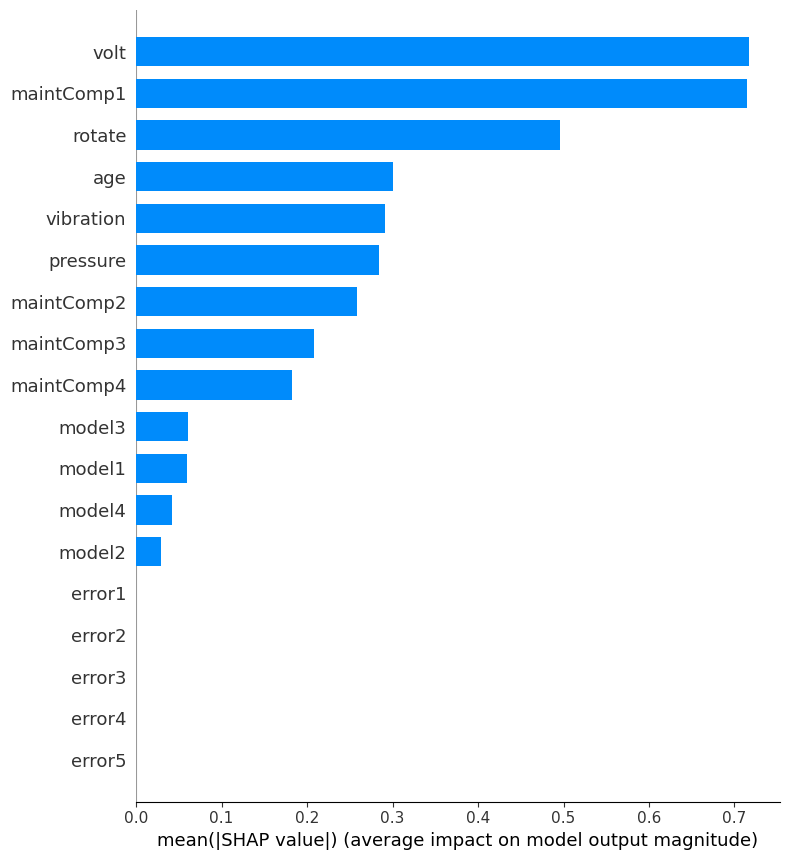

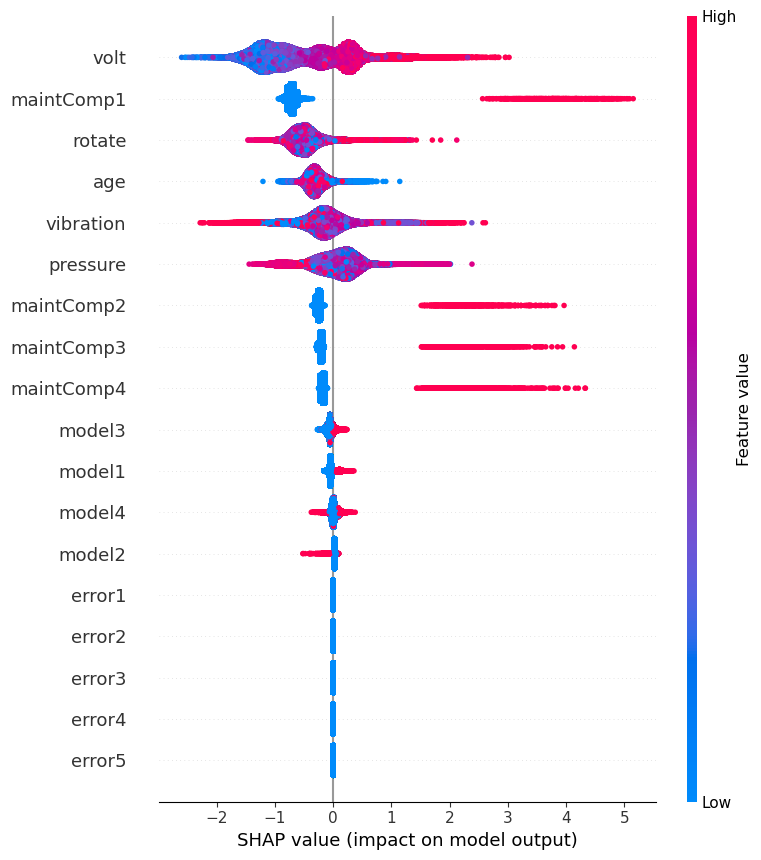

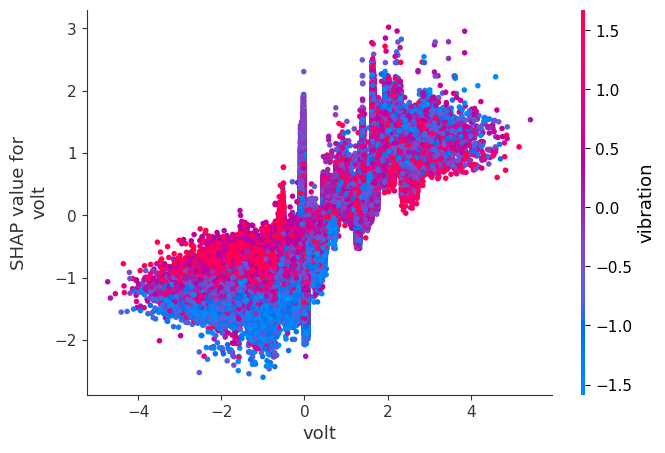

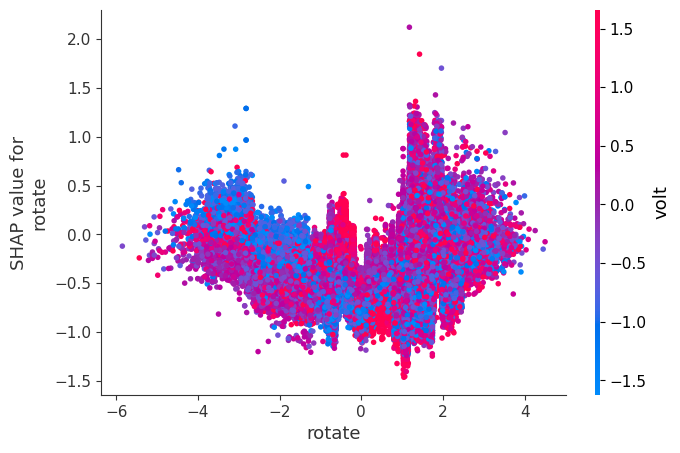

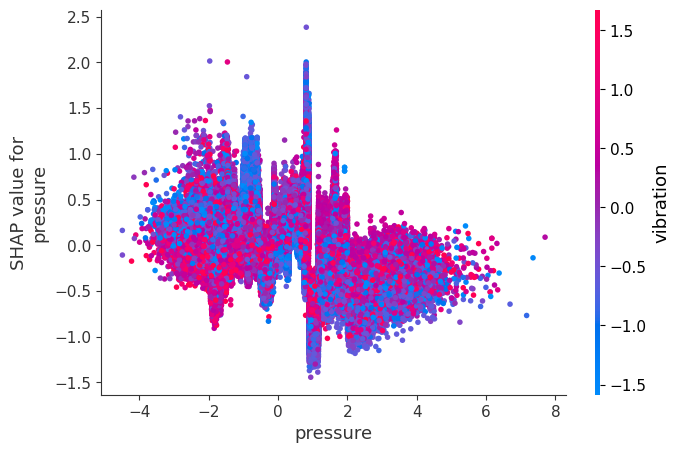

...

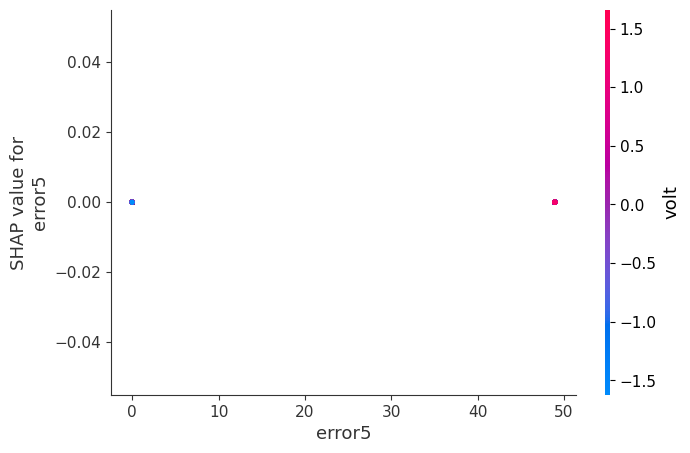

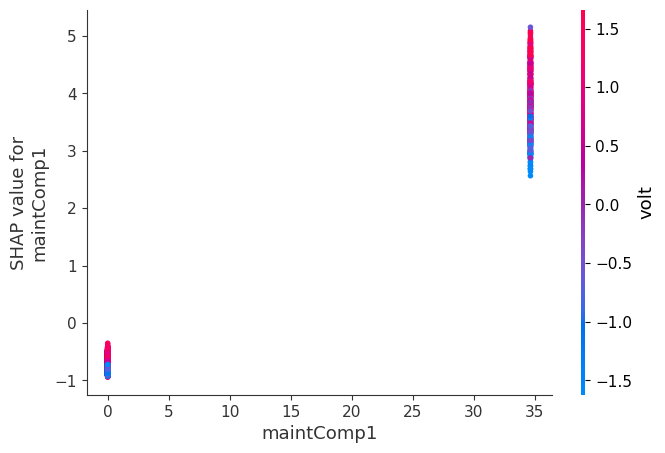

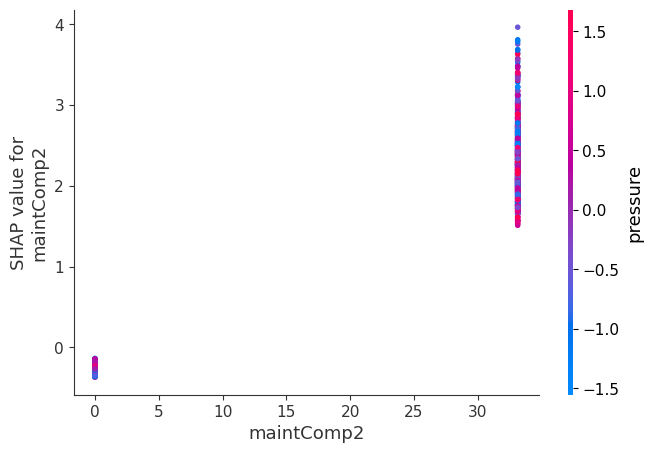

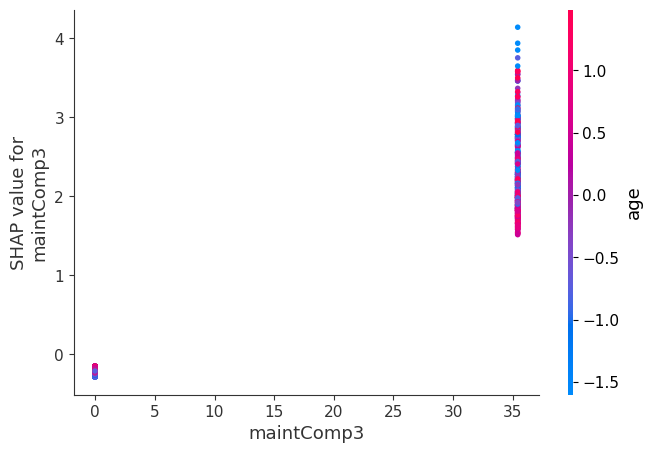

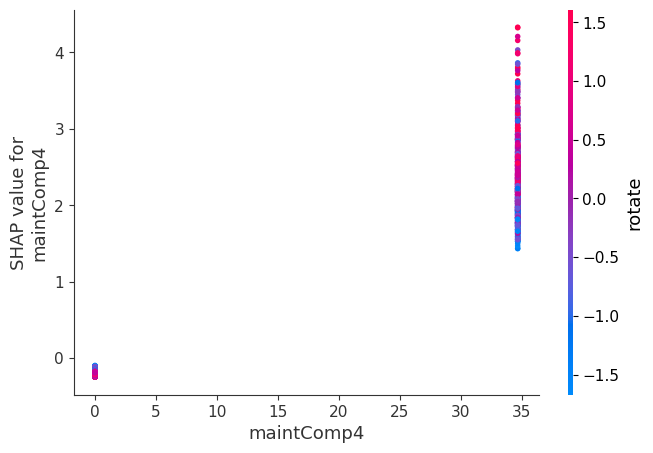

In [50]:
ai1.explain('shap')

In [51]:
ai1.explain('perm')

Explaining Best ANAI model [*]



In [52]:
ai1.result()

,Name,Accuracy,Cross Validated Accuracy,Model
0,XGBoost Classifier,99.912222,99.917494,"XGBClassifier(base_score=0.5, booster='gbtree'..."
1,Random Forest Classifier,99.902532,99.913932,"(DecisionTreeClassifier(max_features='sqrt', r..."
2,CatBoost Classifier,99.902532,99.909942,<catboost.core.CatBoostClassifier object at 0x...
3,Gradient Boosting Classifier,99.862633,99.813471,([DecisionTreeRegressor(criterion='friedman_ms...
4,LightGBM Classifier,99.662567,99.774426,LGBMClassifier()


Se puede concluir que los cinco modelos de clasificación arrojan altos valores de presición, todos superiores al 99%, y el modelo con la más alta precisión es **XGBoost**.

Nótese que además en la tabla de resultados se presenta la presición de la validación cruzada, por lo tanto se aplicará una validación simple de resultados de predicción tomando aleatoriamente una muestra y comparando los resultados.

In [73]:
ai1.result()

,Name,Accuracy,Cross Validated Accuracy,Model
0,XGBoost Classifier,99.912222,99.917494,"XGBClassifier(base_score=0.5, booster='gbtree'..."
1,Random Forest Classifier,99.902532,99.913932,"(DecisionTreeClassifier(max_features='sqrt', r..."
2,CatBoost Classifier,99.902532,99.909942,<catboost.core.CatBoostClassifier object at 0x...
3,Gradient Boosting Classifier,99.862633,99.813471,([DecisionTreeRegressor(criterion='friedman_ms...
4,LightGBM Classifier,99.662567,99.774426,LGBMClassifier()


In [122]:
df_sample = df_train.sample(100000)
df_sample_test = df_sample.drop('failure',axis=1)
df_sample.head()

,volt,rotate,pressure,vibration,age,model1,model2,model3,model4,error1,error2,error3,error4,error5,maintComp1,maintComp2,maintComp3,maintComp4,failure
352573,0.543181,0.569088,0.415062,0.433919,0.45,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
697248,0.413437,0.601507,0.381142,0.294451,0.30,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
707314,0.288629,0.537991,0.281518,0.309343,0.05,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
513607,0.557765,0.510989,0.305172,0.489097,0.85,0,0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
72822,0.564310,0.529838,0.393529,0.361760,0.35,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [123]:
pred = ai1.predict(df_sample_test)

Predicting on Test Set using Best Model[*]

Predicted Value :  [0 0 0 ... 0 0 0] 

Prediction Done [ ✓ ]



In [124]:
error = 0
size = pred.size
for i in range(size):
    if pred[i]!=int(df_sample['failure'].values[i]):
        error = error + 1
        print('Falla en la posición: %6d   Predicción: %2d   Real: %2d' % (i,pred[i],int(df_sample['failure'].values[i])))
error = (error / size) *100
accuracy = 100 - error
print('Error:      %3.2f  ' % (error))
print('Precisión: %3.2f  ' % (accuracy))

Falla en la posición:    517   Predicción:  2   Real:  1
Falla en la posición:   1978   Predicción:  4   Real:  0
Falla en la posición:   3723   Predicción:  0   Real:  1
Falla en la posición:   5652   Predicción:  2   Real:  0
Falla en la posición:   9440   Predicción:  2   Real:  4
Falla en la posición:   9931   Predicción:  0   Real:  1
Falla en la posición:  11649   Predicción:  2   Real:  4
Falla en la posición:  25058   Predicción:  0   Real:  2
Falla en la posición:  39272   Predicción:  0   Real:  1
Falla en la posición:  41977   Predicción:  3   Real:  4
Falla en la posición:  42159   Predicción:  2   Real:  4
Falla en la posición:  43835   Predicción:  1   Real:  3
Falla en la posición:  44303   Predicción:  0   Real:  4
Falla en la posición:  47229   Predicción:  0   Real:  2
Falla en la posición:  50586   Predicción:  1   Real:  0
Falla en la posición:  52937   Predicción:  2   Real:  4
Falla en la posición:  53583   Predicción:  2   Real:  0
Falla en la posición:  54942   